## Importing Libraries


In [209]:
# Data Manipulation Libraries
import pandas as pd
import numpy as np

# Data Vizualization Libraries
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

In [210]:
#import the warnings
import warnings 
warnings.filterwarnings("ignore")

## Reading Dataset

In [317]:
df = pd.read_csv('data.csv')

In [212]:
#print the head of the data frame.
df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit
0,38,technician,married,tertiary,no,127,yes,no,cellular,14,oct,113,1,50,2,success,no
1,41,housemaid,married,primary,no,365,no,no,cellular,8,aug,203,5,-1,0,unknown,no
2,39,management,single,tertiary,no,2454,yes,no,cellular,4,may,716,3,263,2,failure,yes
3,49,blue-collar,married,primary,no,6215,yes,no,cellular,11,may,549,1,-1,0,unknown,no
4,37,services,married,secondary,no,1694,yes,yes,cellular,29,jan,404,2,251,6,failure,no


In [213]:
df.tail()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit
8366,52,management,married,tertiary,no,388,no,no,cellular,25,may,272,1,-1,0,unknown,yes
8367,39,services,married,secondary,no,2758,no,no,cellular,4,feb,658,3,-1,0,unknown,yes
8368,38,blue-collar,married,primary,no,178,yes,no,unknown,20,may,245,1,-1,0,unknown,no
8369,59,retired,divorced,unknown,no,-49,yes,no,unknown,13,may,248,2,-1,0,unknown,no
8370,41,blue-collar,divorced,primary,no,0,no,no,cellular,30,jul,509,2,-1,0,unknown,yes


In [214]:
df.shape

(8371, 17)

In [215]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8371 entries, 0 to 8370
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        8371 non-null   int64 
 1   job        8371 non-null   object
 2   marital    8371 non-null   object
 3   education  8371 non-null   object
 4   default    8371 non-null   object
 5   balance    8371 non-null   int64 
 6   housing    8371 non-null   object
 7   loan       8371 non-null   object
 8   contact    8371 non-null   object
 9   day        8371 non-null   int64 
 10  month      8371 non-null   object
 11  duration   8371 non-null   int64 
 12  campaign   8371 non-null   int64 
 13  pdays      8371 non-null   int64 
 14  previous   8371 non-null   int64 
 15  poutcome   8371 non-null   object
 16  deposit    8371 non-null   object
dtypes: int64(7), object(10)
memory usage: 1.1+ MB


## Data Cleaning

In [216]:
df.isnull().sum()

age          0
job          0
marital      0
education    0
default      0
balance      0
housing      0
loan         0
contact      0
day          0
month        0
duration     0
campaign     0
pdays        0
previous     0
poutcome     0
deposit      0
dtype: int64

In [217]:
df.duplicated().sum()

0

In [218]:
df.describe()

,age,balance,day,duration,campaign,pdays,previous
count,8371.000000,8371.000000,8371.000000,8371.000000,8371.000000,8371.000000,8371.000000
mean,41.197467,1517.811134,15.588460,372.898698,2.512603,49.911958,0.823677
std,11.809300,3225.312218,8.406768,346.706743,2.734037,107.308417,2.315285
min,18.000000,-3058.000000,1.000000,2.000000,1.000000,-1.000000,0.000000
25%,32.000000,116.000000,8.000000,137.000000,1.000000,-1.000000,0.000000
50%,39.000000,532.000000,15.000000,255.000000,2.000000,-1.000000,0.000000
75%,49.000000,1694.000000,21.000000,504.000000,3.000000,2.000000,1.000000
max,95.000000,81204.000000,31.000000,3284.000000,63.000000,854.000000,58.000000


### Imputing missing values

-1 indicates the missing values. Missing value does not always be present as null. 

To handle it:

We need to ignore the missing values in the calculations by simply making it missing - replace -1 with NaN.

In [219]:
df.pdays.value_counts()

-1      6268
 92       87
 182      69
 181      65
 91       62
        ... 
 61        1
 373       1
 395       1
 132       1
 403       1
Name: pdays, Length: 426, dtype: int64

In [220]:
#describe the pdays column with considering the -1 values.
df.loc[df.pdays<0 , "pdays"] = np.NaN
df.pdays.describe()

count    2103.000000
mean      201.655254
std       122.825116
min         1.000000
25%        97.000000
50%       182.000000
75%       277.000000
max       854.000000
Name: pdays, dtype: float64

In [221]:
#describe the age variable in dataset.
df.age.describe()

count    8371.000000
mean       41.197467
std        11.809300
min        18.000000
25%        32.000000
50%        39.000000
75%        49.000000
max        95.000000
Name: age, dtype: float64

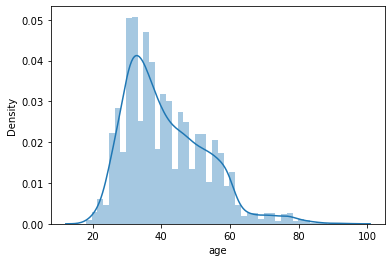

In [222]:
#describe the age variable in dataset using histogram with outliers.
sns.distplot(df['age'])
plt.show()

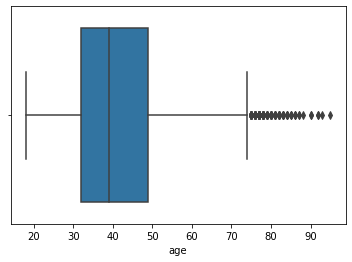

In [223]:
#describe the age variable outliers.
sns.boxplot(df['age'])
plt.show()

In [224]:
# unique jobs present in dataset.
df.job.value_counts()

management       1923
blue-collar      1472
technician       1371
admin.           1017
services          671
retired           563
self-employed     307
unemployed        282
student           273
entrepreneur      244
housemaid         197
unknown            51
Name: job, dtype: int64

In [225]:
# unique jobs present in dataset in percentage.
df.job.value_counts(normalize=True)*100

management       22.972166
blue-collar      17.584518
technician       16.377972
admin.           12.149086
services          8.015769
retired           6.725600
self-employed     3.667423
unemployed        3.368773
student           3.261259
entrepreneur      2.914825
housemaid         2.353363
unknown           0.609246
Name: job, dtype: float64

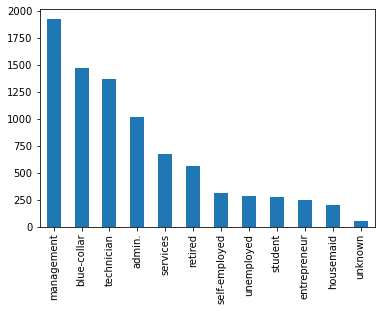

In [226]:
# jobs count in dataset plotted using bar chart.
df.job.value_counts().plot.bar()
plt.show()

In [227]:
# unique marital values present in dataset.
df.marital.value_counts()

married     4744
single      2645
divorced     982
Name: marital, dtype: int64

In [228]:
# unique marital values present in dataset in percentage.
df.marital.value_counts(normalize=True)*100

married     56.671843
single      31.597181
divorced    11.730976
Name: marital, dtype: float64

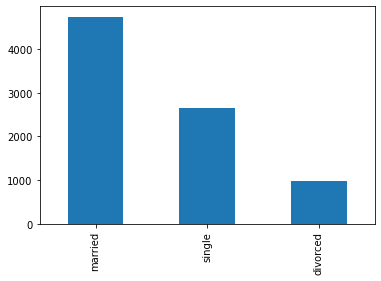

In [229]:
# marital count in dataset plotted using bar chart.
df.marital.value_counts().plot.bar()
plt.show()

In [230]:
# unique education values present in dataset.
df.education.value_counts()

secondary    4113
tertiary     2754
primary      1128
unknown       376
Name: education, dtype: int64

In [231]:
# unique education values present in dataset in percentage.
df.education.value_counts(normalize=True)*100

secondary    49.133915
tertiary     32.899295
primary      13.475093
unknown       4.491698
Name: education, dtype: float64

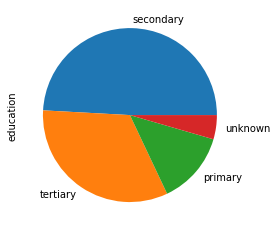

In [232]:
# education values present in dataset plotted using pie chart.
df.education.value_counts().plot.pie()
plt.show()

In [233]:
# unique poutcome values present in dataset.
df.poutcome.value_counts()

unknown    6269
failure     895
success     807
other       400
Name: poutcome, dtype: int64

In [234]:
# unique poutcome values present in dataset in percentage.
df.poutcome.value_counts(normalize=True)*100

unknown    74.889499
failure    10.691674
success     9.640425
other       4.778402
Name: poutcome, dtype: float64

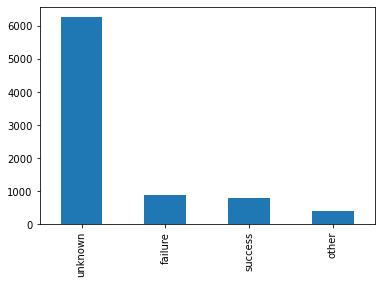

In [235]:
# poutcome values present in dataset plotted using bar chart.
df.poutcome.value_counts().plot.bar()
plt.show()

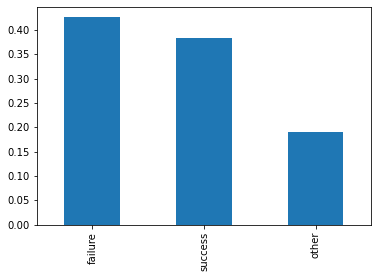

In [236]:
# poutcome values present in dataset plotted using bar chart except unkown values.
df[~(df.poutcome=='unknown')].poutcome.value_counts(normalize=True).plot.bar()
plt.show()

In [237]:
# unique deposit values present in dataset.
df.deposit.value_counts()

no     4428
yes    3943
Name: deposit, dtype: int64

In [238]:
# unique deposit values present in dataset in percentage.
df.deposit.value_counts(normalize=True)*100

no     52.896906
yes    47.103094
Name: deposit, dtype: float64

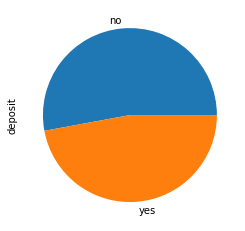

In [239]:
# deposit values present in dataset plotted using pie chart.
df.deposit.value_counts(normalize=True).plot.pie()
plt.show()

In [240]:
# describe balance variable. 
df.balance.describe()

count     8371.000000
mean      1517.811134
std       3225.312218
min      -3058.000000
25%        116.000000
50%        532.000000
75%       1694.000000
max      81204.000000
Name: balance, dtype: float64

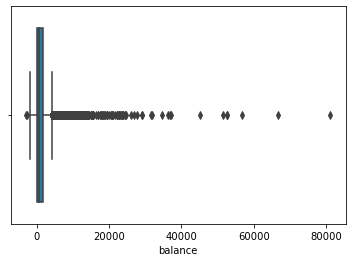

In [241]:
#plot the boxplot of balance variable
sns.boxplot(df['balance'])
plt.show()

<AxesSubplot:xlabel='balance'>

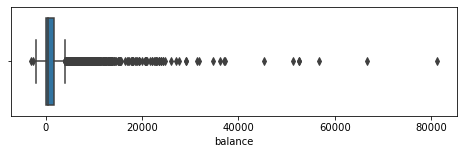

In [242]:
#plot the boxplot of balance variable after scaling in 8:2.
plt.figure(figsize=(8,2))
sns.boxplot(df.balance)

In [243]:
#print the quantile (0.5, 0.7, 0.9, 0.95 and 0.99) of balance variable
df.balance.quantile([0.5, 0.7, 0.9, 0.95,0.99])

0.50      532.0
0.70     1319.0
0.90     3842.0
0.95     6101.5
0.99    13362.4
Name: balance, dtype: float64

In [244]:
#describe the duration variable
df.duration.describe()

count    8371.000000
mean      372.898698
std       346.706743
min         2.000000
25%       137.000000
50%       255.000000
75%       504.000000
max      3284.000000
Name: duration, dtype: float64

In [245]:
df.default.value_counts()

no     8244
yes     127
Name: default, dtype: int64

In [246]:
df.housing.value_counts()

no     4354
yes    4017
Name: housing, dtype: int64

In [247]:
df.loan.value_counts()

no     7250
yes    1121
Name: loan, dtype: int64

In [248]:
df.contact.value_counts()

cellular     6041
unknown      1763
telephone     567
Name: contact, dtype: int64

In [249]:
df.month.value_counts()

may    2135
jul    1152
aug    1150
jun     912
nov     698
apr     661
feb     595
oct     280
jan     257
sep     241
mar     199
dec      91
Name: month, dtype: int64

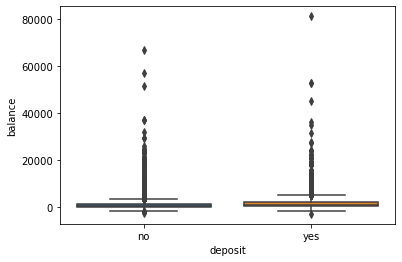

In [250]:
#plot the box plot of balance for yes & no responses.
sns.boxplot(data=df,x='deposit',y='balance')
plt.show()

In [251]:
#groupby the response to find the mean of the balance with response no & yes seperatly.
df.groupby("deposit")['balance'].mean()

deposit
no     1295.932701
yes    1766.981233
Name: balance, dtype: float64

In [252]:
#groupby the response to find the median of the balance with response no & yes seperatly.
df.groupby("deposit")['balance'].median()

deposit
no     413.0
yes    699.0
Name: balance, dtype: float64

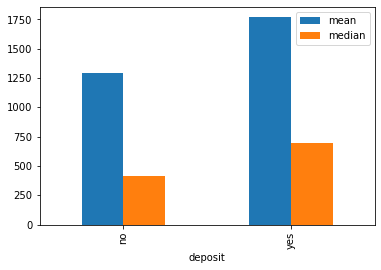

In [253]:
#plot the bar graph of balance's mean an median with response.
df.groupby("deposit")['balance'].aggregate(["mean","median"]).plot.bar()
plt.show()

Text(0.5, 1.0, 'Quartile 1 distribution for the feature duration')

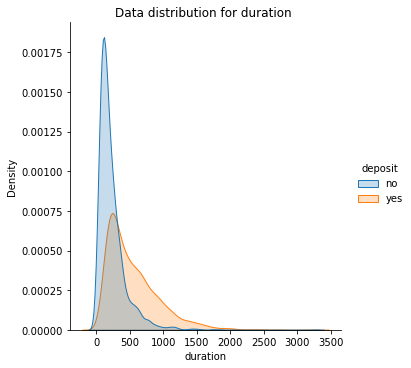

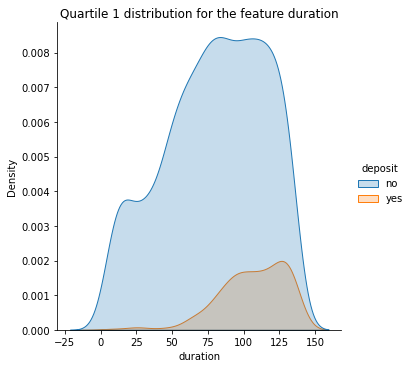

In [254]:
sns.displot(df, x="duration", hue="deposit", kind="kde", fill=True)
plt.title("Data distribution for duration ")
lower_limit=df['duration'].quantile(0.25)
q1=df.loc[(df['duration'] < lower_limit)]
sns.displot(q1, x="duration", hue="deposit", kind="kde", fill=True)
plt.title("Quartile 1 distribution for the feature duration")

### Correlation  matrix

<AxesSubplot:>

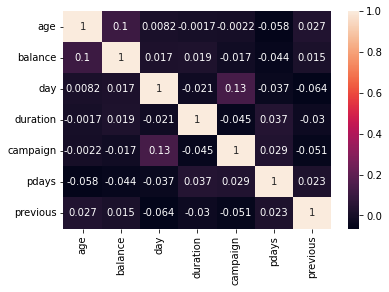

In [255]:
df_corr=df.corr()
sns.heatmap(df_corr,annot=True)

### Numerical - Categorical value analysis

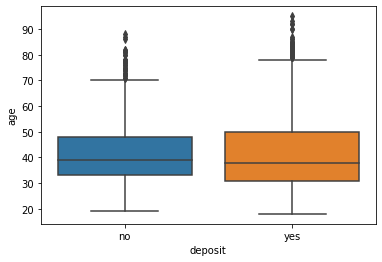

In [256]:
sns.boxplot(data = df, y= 'age', x='deposit')
plt.show()

In [318]:
#create the buckets of <30, 30-40, 40-50 50-60 and 60+ from age column.
df['age_group'] = pd.cut(df.age, [0,30,40,50,60,9999], labels = ['<30','30-40','40-50','50-60','60+'])

In [319]:
df.age.head()

0    38
1    41
2    39
3    49
4    37
Name: age, dtype: int64

In [320]:
df.age_group.value_counts(normalize = True)*100

30-40    37.558237
40-50    22.530164
<30      17.847330
50-60    16.724406
60+       5.339864
Name: age_group, dtype: float64

### Categorical - Categorical value analysis

In [321]:
df['deposit_flag'] = np.where(df.deposit == 'yes', 1, 0)
df.deposit_flag.value_counts()

0    4428
1    3943
Name: deposit_flag, dtype: int64

In [322]:
df.deposit_flag.value_counts(normalize=True)*100

0    52.896906
1    47.103094
Name: deposit_flag, dtype: float64

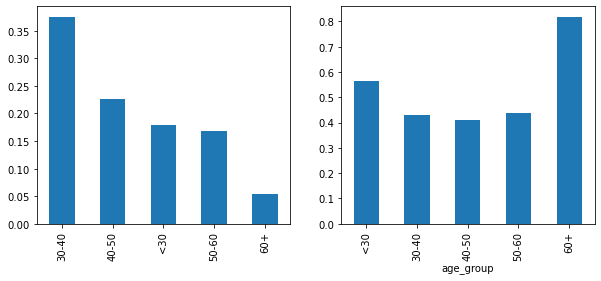

In [262]:
#plot the percentage of each buckets and average values of response_flag in each buckets. plot in subplots.
plt.figure(figsize = [10,4])
plt.subplot(1,2,1)
df.age_group.value_counts(normalize = True).plot.bar()
plt.subplot(1,2,2)
df.groupby(['age_group'])['deposit_flag'].mean().plot.bar()
plt.show()

In [265]:
df.deposit_flag.mean()

0.47103094015051966

### Marital vs Response

In [266]:
df.groupby('marital')['deposit_flag'].mean()

marital
divorced    0.478615
married     0.427698
single      0.545936
Name: deposit_flag, dtype: float64

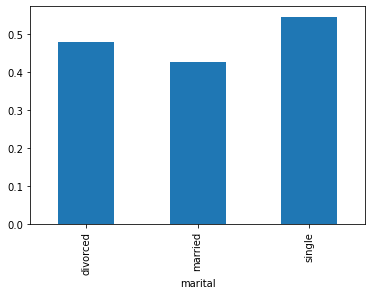

In [267]:
df.groupby('marital')['deposit_flag'].mean().plot.bar()
plt.show()

### Job vs Response

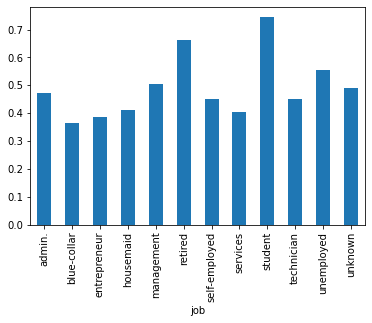

In [268]:
df.groupby('job')['deposit_flag'].mean().plot.bar()
plt.show()

### Loan vs Response

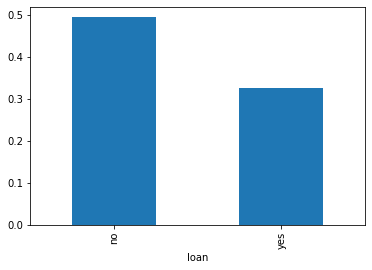

In [269]:
df.groupby('loan')['deposit_flag'].mean().plot.bar()
plt.show()

### Housing Loan vs Response

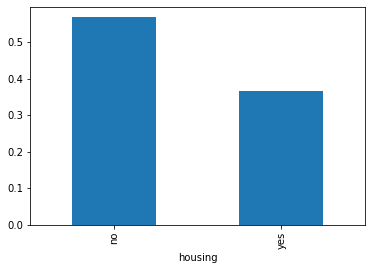

In [270]:
df.groupby('housing')['deposit_flag'].mean().plot.bar()
plt.show()

### Education vs Response

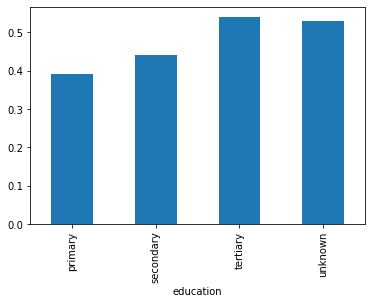

In [271]:
df.groupby('education')['deposit_flag'].mean().plot.bar()
plt.show()

### Multivariate Analysis

#### Education vs Marital vs Response

In [272]:
result = pd.pivot_table (data = df , index = 'education', columns= 'marital', values='deposit_flag')
result

marital,divorced,married,single
education,,,
primary,0.519737,0.357143,0.460000
secondary,0.447937,0.405498,0.502351
tertiary,0.515901,0.494898,0.603276
unknown,0.447368,0.509174,0.591667


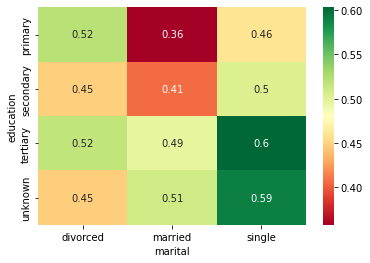

In [273]:
sns.heatmap(result, annot = True,cmap = 'RdYlGn')
plt.show()

#### Job vs Marital vs Response

In [274]:
result2 = pd.pivot_table (data = df , index = 'job', columns= 'marital', values='deposit_flag')
result2

marital,divorced,married,single
job,,,
admin.,0.468531,0.450485,0.504178
blue-collar,0.403509,0.319802,0.477011
entrepreneur,0.312500,0.360465,0.550000
housemaid,0.393939,0.372263,0.629630
management,0.476190,0.476323,0.562893
retired,0.691729,0.661800,0.473684
self-employed,0.593750,0.316770,0.596491
services,0.453488,0.342391,0.488479
student,0.500000,0.750000,0.745174


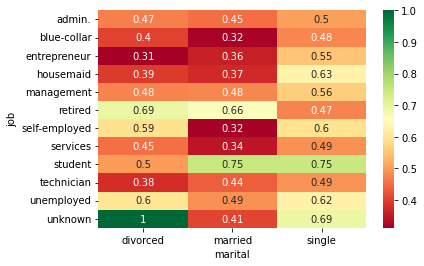

In [84]:
sns.heatmap(result2, annot = True,cmap = 'RdYlGn')
plt.show()

#### Education vs Poutcome vs Response

In [275]:
result3 = pd.pivot_table (data = df , index = 'education', columns= 'poutcome', values='deposit_flag')
result3

poutcome,failure,other,success,unknown
education,,,,
primary,0.405941,0.500000,0.915254,0.353448
secondary,0.451404,0.517413,0.907104,0.378852
tertiary,0.597315,0.601399,0.913433,0.464105
unknown,0.606061,0.562500,0.893617,0.457143


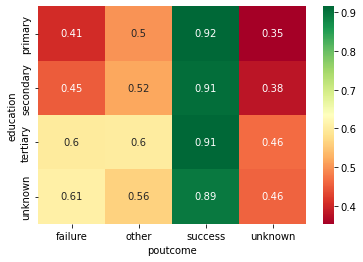

In [276]:
sns.heatmap(result3, annot = True,cmap = 'RdYlGn')
plt.show()

In [277]:
df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit,age_group,deposit_flag
0,38,technician,married,tertiary,no,127,yes,no,cellular,14,oct,113,1,50.0,2,success,no,30-40,0
1,41,housemaid,married,primary,no,365,no,no,cellular,8,aug,203,5,NaN,0,unknown,no,40-50,0
2,39,management,single,tertiary,no,2454,yes,no,cellular,4,may,716,3,263.0,2,failure,yes,30-40,1
3,49,blue-collar,married,primary,no,6215,yes,no,cellular,11,may,549,1,NaN,0,unknown,no,40-50,0
4,37,services,married,secondary,no,1694,yes,yes,cellular,29,jan,404,2,251.0,6,failure,no,30-40,0


In [282]:
df.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays',
       'previous', 'poutcome', 'deposit', 'age_group', 'deposit_flag'],
      dtype='object')

In [323]:
df.drop(['deposit_flag','age_group'], axis=1, inplace=True)
df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit
0,38,technician,married,tertiary,no,127,yes,no,cellular,14,oct,113,1,50,2,success,no
1,41,housemaid,married,primary,no,365,no,no,cellular,8,aug,203,5,-1,0,unknown,no
2,39,management,single,tertiary,no,2454,yes,no,cellular,4,may,716,3,263,2,failure,yes
3,49,blue-collar,married,primary,no,6215,yes,no,cellular,11,may,549,1,-1,0,unknown,no
4,37,services,married,secondary,no,1694,yes,yes,cellular,29,jan,404,2,251,6,failure,no


In [324]:
category_features = ['job','marital','education','default','housing','loan','month','day','poutcome']
df[category_features].head()

,job,marital,education,default,housing,loan,month,day,poutcome
0,technician,married,tertiary,no,yes,no,oct,14,success
1,housemaid,married,primary,no,no,no,aug,8,unknown
2,management,single,tertiary,no,yes,no,may,4,failure
3,blue-collar,married,primary,no,yes,no,may,11,unknown
4,services,married,secondary,no,yes,yes,jan,29,failure


In [325]:
df1 = pd.get_dummies(df, columns = category_features)
df1 = pd.get_dummies(df1, columns = ['deposit'],drop_first=True)
df1.drop('contact',axis=1,inplace=True)
df1['pdays'] = df1['pdays'].replace(np.NaN,0)
df1.head()

,age,balance,duration,campaign,pdays,previous,job_admin.,job_blue-collar,job_entrepreneur,job_housemaid,...,day_27,day_28,day_29,day_30,day_31,poutcome_failure,poutcome_other,poutcome_success,poutcome_unknown,deposit_yes
0,38,127,113,1,50,2,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
1,41,365,203,5,-1,0,0,0,0,1,...,0,0,0,0,0,0,0,0,1,0
2,39,2454,716,3,263,2,0,0,0,0,...,0,0,0,0,0,1,0,0,0,1
3,49,6215,549,1,-1,0,0,1,0,0,...,0,0,0,0,0,0,0,0,1,0
4,37,1694,404,2,251,6,0,0,0,0,...,0,0,1,0,0,1,0,0,0,0


### Importing ML Libraries

In [286]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier

In [326]:
df2 = df1.copy()
X = df1.drop(columns=['deposit_yes'])
y = df1['deposit_yes']
ssc = StandardScaler(with_mean=True,with_std=True)
ssc.fit_transform(X)

array([[-2.70774595e-01, -4.31243278e-01, -7.49665901e-01,
        -5.53281889e-01,  8.20507019e-04,  5.08098760e-01,
        -3.71876439e-01, -4.61913689e-01, -1.73272557e-01,
        -1.55244348e-01, -5.46106226e-01, -2.68524734e-01,
        -1.95116469e-01, -2.95199690e-01, -1.83608354e-01,
         2.25959337e+00, -1.86714109e-01, -7.82930884e-02,
        -3.64554875e-01,  8.74382461e-01, -6.79652888e-01,
        -3.94634734e-01, -9.82825749e-01,  1.42813823e+00,
        -2.16862614e-01,  1.24117457e-01, -1.24117457e-01,
        -1.04110204e+00,  1.04110204e+00,  3.93218374e-01,
        -3.93218374e-01, -2.92801664e-01, -3.99071072e-01,
        -1.04834814e-01, -2.76617949e-01, -1.77970926e-01,
        -3.99473264e-01, -3.49668987e-01, -1.56049492e-01,
        -5.85121271e-01, -3.01609566e-01,  5.37553984e+00,
        -1.72172287e-01, -1.04250912e-01, -1.78327826e-01,
        -1.67707387e-01, -1.93461083e-01, -2.12600919e-01,
        -2.04492177e-01, -1.88420346e-01, -1.99689200e-0

In [315]:
X.columns

Index(['age', 'balance', 'duration', 'campaign', 'pdays', 'previous',
       'job_admin.', 'job_blue-collar', 'job_entrepreneur', 'job_housemaid',
       'job_management', 'job_retired', 'job_self-employed', 'job_services',
       'job_student', 'job_technician', 'job_unemployed', 'job_unknown',
       'marital_divorced', 'marital_married', 'marital_single',
       'education_primary', 'education_secondary', 'education_tertiary',
       'education_unknown', 'default_no', 'default_yes', 'housing_no',
       'housing_yes', 'loan_no', 'loan_yes', 'month_apr', 'month_aug',
       'month_dec', 'month_feb', 'month_jan', 'month_jul', 'month_jun',
       'month_mar', 'month_may', 'month_nov', 'month_oct', 'month_sep',
       'day_1', 'day_2', 'day_3', 'day_4', 'day_5', 'day_6', 'day_7', 'day_8',
       'day_9', 'day_10', 'day_11', 'day_12', 'day_13', 'day_14', 'day_15',
       'day_16', 'day_17', 'day_18', 'day_19', 'day_20', 'day_21', 'day_22',
       'day_23', 'day_24', 'day_25', 'day_26', '

In [327]:
x_train, x_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42)

## Logisitic Regression

In [328]:
log = LogisticRegression()
log.fit(x_train,y_train)
y_pred = log.predict(x_test)
print('Accuracy Score : %f' % (accuracy_score(y_pred, y_test)))
parameters = {'C':[0.001, 0.1, 1, 10, 100]}
log_gsmodel = GridSearchCV(estimator=log, param_grid = parameters)
log_gsmodel_result = log_gsmodel.fit(x_train,y_train)
print("Best: %f using %s" % (log_gsmodel_result.best_score_, log_gsmodel_result.best_params_))
print('mean_test_score : %s' % (log_gsmodel_result.cv_results_['mean_test_score']))
print('std_test_Score : %s' % (log_gsmodel_result.cv_results_['std_test_score']))
print('params: %s' %(log_gsmodel_result.cv_results_['params']))

Accuracy Score : 0.809552
Best: 0.790473 using {'C': 10}
mean_test_score : [0.77075875 0.79032437 0.78912878 0.79047284 0.78823259]
std_test_Score : [0.00662601 0.00736037 0.01109484 0.0068253  0.01021828]
params: [{'C': 0.001}, {'C': 0.1}, {'C': 1}, {'C': 10}, {'C': 100}]


### Decision Tree Entropy

In [329]:
ds_tree_entropy = DecisionTreeClassifier(criterion='entropy',random_state=42)
ds_tree_entropy.fit(x_train,y_train)
ds_tree_entropy_y_pred = ds_tree_entropy.predict(x_test)
ds_tree_entropy_y_pred

array([1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0,
       1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1,
       0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1,
       0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0,
       1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0,
       1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0,
       1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0,
       0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0,
       1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0,
       1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0,
       0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0,
       0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,

In [292]:
print("Model Entropy - no max depth")
print("Accuracy:", metrics.accuracy_score(y_test,ds_tree_entropy_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test,ds_tree_entropy_y_pred))
print('Precision score for "Yes"' , metrics.precision_score(y_test,ds_tree_entropy_y_pred, pos_label = 1))
print('Precision score for "No"' , metrics.precision_score(y_test,ds_tree_entropy_y_pred, pos_label = 0))
print('Recall score for "Yes"' , metrics.recall_score(y_test,ds_tree_entropy_y_pred, pos_label = 1))
print('Recall score for "No"' , metrics.recall_score(y_test,ds_tree_entropy_y_pred, pos_label = 0))

Model Entropy - no max depth
Accuracy: 0.7582089552238805
Balanced accuracy: 0.7557655124677509
Precision score for "Yes" 0.7608108108108108
Precision score for "No" 0.7561497326203208
Recall score for "Yes" 0.7117572692793932
Recall score for "No" 0.7997737556561086


## Gaussian Naive Bayes

In [330]:
nb = GaussianNB()
nb_result = nb.fit(x_train,y_train)
nb_y_pred = nb.predict(x_test)
print(accuracy_score(nb_y_pred,y_test))

0.7343283582089553


## Random Forest Classifier

In [331]:
rfm = RandomForestClassifier(n_estimators=20,oob_score=True,n_jobs=1,random_state=42,max_features=None,min_samples_leaf=10)
rfm.fit(x_train,y_train)
rfm_y_pred = rfm.predict(x_test)
print(accuracy_score(rfm_y_pred,y_test))

0.8388059701492537


In [332]:
print(classification_report(rfm_y_pred,y_test))

              precision    recall  f1-score   support

           0       0.83      0.86      0.84       848
           1       0.85      0.81      0.83       827

    accuracy                           0.84      1675
   macro avg       0.84      0.84      0.84      1675
weighted avg       0.84      0.84      0.84      1675



In [333]:
rfm_parameters = {'n_estimators': [80,90,100]}
rfm_gsmodel = GridSearchCV(estimator=RandomForestClassifier(oob_score=True,n_jobs=1,random_state=42,max_features=None,min_samples_leaf=10), param_grid = rfm_parameters)
rfm_gsmodel_result = rfm_gsmodel.fit(x_train,y_train)
print("Best: %f using %s" % (rfm_gsmodel_result.best_score_, rfm_gsmodel_result.best_params_))
print('mean_test_score : %s' % (rfm_gsmodel_result.cv_results_['mean_test_score']))
print('std_test_Score : %s' % (rfm_gsmodel_result.cv_results_['std_test_score']))
print('params: %s' %(rfm_gsmodel_result.cv_results_['params']))

Best: 0.823627 using {'n_estimators': 80}
mean_test_score : [0.82362723 0.82317914 0.82317925]
std_test_Score : [0.00451624 0.00434274 0.00451421]
params: [{'n_estimators': 80}, {'n_estimators': 90}, {'n_estimators': 100}]


Classification accuracy for the Random forest classifier worked well and the percentage of accurate prediction is obtained as 83%.

In [335]:
d_t = pd.read_csv('test_data.csv')

In [336]:
d_t1 = pd.get_dummies(d_t, columns = category_features)

In [337]:
d_t1.drop('contact',axis=1,inplace=True)
d_t1['pdays'] = df1['pdays'].replace(np.NaN,0)

In [338]:
x = d_t1
ssc = StandardScaler(with_mean=True,with_std=True)
ssc.fit_transform(x)

array([[-8.46137783e-01, -3.35990662e-01,  1.62813225e-01,
        -1.84626632e-01,  3.41850245e-02,  2.31513334e+00,
        -3.57956113e-01,  2.21655940e+00, -1.76155219e-01,
        -1.68438142e-01, -5.47127253e-01, -2.88899174e-01,
        -1.90763315e-01, -3.15042337e-01, -1.79372674e-01,
        -4.39596379e-01, -1.66175024e-01, -8.27904394e-02,
        -3.54123179e-01, -1.16501653e+00,  1.48223539e+00,
        -3.92151189e-01,  1.02356676e+00, -7.09768661e-01,
        -2.12881075e-01, -8.18982117e+00,  8.18982117e+00,
         9.09816939e-01, -9.09816939e-01,  3.71825881e-01,
        -3.71825881e-01, -3.21866836e-01, -3.90324771e-01,
        -8.27904394e-02, -2.63341336e-01, -1.79372674e-01,
        -3.86047308e-01, -3.53482131e-01, -1.68438142e-01,
        -5.72523418e-01,  3.22363719e+00, -2.04466731e-01,
        -1.69559608e-01, -1.07695892e-01, -1.67309992e-01,
        -1.68438142e-01, -1.92771644e-01, -2.07303133e-01,
        -2.02557317e-01, -1.87716245e-01, -1.91769736e-0

In [310]:
import sys

np.set_printoptions(threshold=sys.maxsize)

In [303]:
rfm_y_pred = rfm.predict(X)

In [311]:
print(rfm_y_pred)

[1 1 0 1 0 1 0 0 1 0 1 0 1 0 1 0 1 0 0 0 1 0 0 0 0 1 0 1 1 1 0 1 1 1 0 1 0
 0 0 0 0 0 0 1 0 0 0 1 1 0 0 0 1 0 0 1 0 0 0 0 0 1 1 1 1 0 0 0 0 0 0 0 1 1
 0 0 0 0 1 0 1 1 1 1 0 1 0 1 0 1 0 0 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 0
 0 0 1 0 1 1 0 0 1 1 1 1 1 1 0 0 1 1 1 1 0 0 0 0 0 0 1 0 1 0 1 0 0 0 0 0 1
 1 1 1 1 1 1 0 1 1 1 0 0 1 0 0 0 0 0 1 0 0 1 0 0 0 1 0 1 0 0 0 0 1 1 1 1 0
 0 0 0 1 1 0 0 1 0 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 0 0 0 1 0 1 0 1 0 0
 1 0 0 0 0 1 0 1 0 1 1 1 0 0 1 0 1 1 0 1 0 0 1 1 1 1 0 1 1 0 0 0 0 0 0 1 0
 1 0 0 1 1 1 0 0 0 1 1 0 0 1 0 1 0 1 0 1 0 0 1 1 1 1 1 0 1 0 1 0 1 1 0 1 1
 1 1 1 0 0 1 1 1 0 0 0 0 0 1 1 0 1 1 0 0 0 1 1 1 1 0 1 1 0 1 1 1 1 0 0 1 0
 1 1 0 1 0 1 1 0 0 1 1 0 0 0 0 0 1 0 0 0 0 1 0 1 1 1 0 1 1 1 1 0 0 0 0 0 1
 0 0 0 0 0 1 1 1 1 0 0 1 0 0 1 0 1 0 1 1 0 0 0 1 1 0 1 0 0 0 0 1 1 1 1 0 1
 1 1 0 0 1 0 0 0 1 1 1 1 0 0 1 1 0 0 1 0 1 1 0 1 1 0 0 1 1 1 1 1 1 0 0 0 1
 0 0 1 0 1 0 1 1 1 0 0 1 1 0 0 0 0 0 0 1 0 0 1 0 0 1 1 1 0 1 1 1 0 0 1 1 0
 1 0 1 1 0 0 1 0 1 1 0 1 